# Building Recommender Systems with Spotify Data

## Import Libraries

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import spotipy

import os
# username = os.environ['PLOTLY_USERNAME']
# api_key = os.environ['PLOTLY_API_KEY']
# chart_studio.tools.set_credentials_file(username=username, api_key=api_key)
# plt.rcParams.update({'font.size': 22})
%matplotlib inline

## Reading the Data

In [4]:
spotify_data = pd.read_csv('data.csv.zip')
genre_data = pd.read_csv('data_by_genres.csv')
data_by_year = pd.read_csv('data_by_year.csv')
spotify_data.head(10)

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665
5,0.1960,1921,0.579,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.697,395076,0.346,0,4pyw9DVHGStUre4J6hPngr,0.168000,2,0.130,-12.506,1,Gati Mardika,6,1921,0.0700,119.824
6,0.4060,1921,0.996,['John McCormack'],0.518,159507,0.203,0,5uNZnElqOS3W4fRmRYPk4T,0.000000,0,0.115,-10.589,1,The Wearing of the Green,4,1921,0.0615,66.221
7,0.0731,1921,0.993,['Sergei Rachmaninoff'],0.389,218773,0.088,0,02GDntOXexBFUvSgaXLPkd,0.527000,1,0.363,-21.091,0,"Morceaux de fantaisie, Op. 3: No. 2, Prélude i...",2,1921,0.0456,92.867
8,0.7210,1921,0.996,['Ignacio Corsini'],0.485,161520,0.130,0,05xDjWH9ub67nJJk82yfGf,0.151000,5,0.104,-21.508,0,La Mañanita - Remasterizado,0,1921-03-20,0.0483,64.678
9,0.7710,1921,0.982,['Fortugé'],0.684,196560,0.257,0,08zfJvRLp7pjAb94MA9JmF,0.000000,8,0.504,-16.415,1,Il Etait Syndiqué,0,1921,0.3990,109.378


In [5]:
spotify_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [6]:
genre_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [7]:
data_by_year.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


## Exploratory Data Analysis

c:\Users\Waleed\AppData\Local\Programs\Python\Python38\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='popularity', ylabel='Density'>

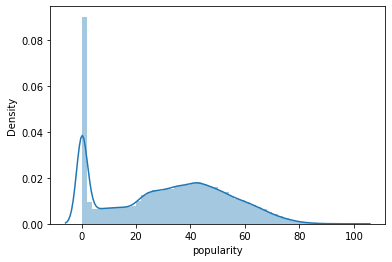

In [8]:
sns.distplot(spotify_data['popularity'])

### Music Over Time

In [9]:
def get_decade(year):
    
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    
    return decade

spotify_data['decade'] = spotify_data['year'].apply(get_decade)

c:\Users\Waleed\AppData\Local\Programs\Python\Python38\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='decade', ylabel='count'>

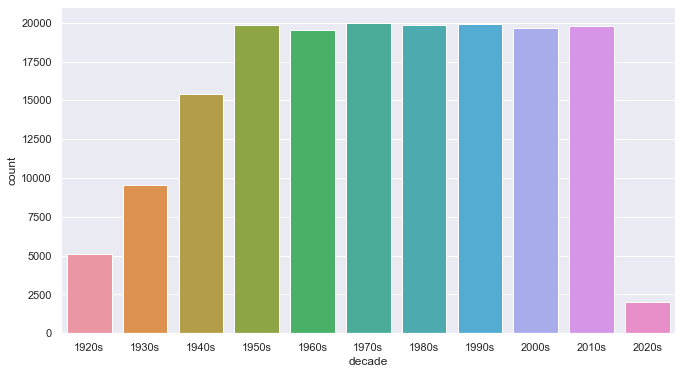

In [10]:
sns.set(rc={'figure.figsize':(11 ,6)})
sns.countplot(spotify_data['decade'])

In [11]:
import plotly.express as px 

sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(data_by_year, x='year', y=sound_features)

fig.show()




In [12]:
fig = px.line(data_by_year, x='year', y='tempo')

fig.show()




### Characteristics of Different Genres

In [13]:
top10_genres = genre_data.nlargest(10, 'popularity')

In [14]:
fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')

fig.show()



## Clustering Genres

In [15]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10, n_jobs=-1))])

X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

c:\Users\Waleed\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\cluster\_kmeans.py:792: FutureWarning:

'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).



In [16]:
from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=2))])
genre_embedding = tsne_pipeline.fit_transform(X)

projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.009s...
[t-SNE] Computed neighbors for 2973 samples in 0.316s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] Computed conditional probabilities in 0.100s
[t-SNE] Iteration 50: error = 81.9547043, gradient norm = 0.0084253 (50 iterations in 0.840s)
[t-SNE] Iteration 100: error = 76.7576828, gradient norm = 0.0173045 (50 iterations in 0.817s)
[t-SNE] Iteration 150: error = 76.1471252, gradient norm = 0.0027878 (50 iterations in 0.747s)
[t-SNE] Iteration 200: error = 76.1190872, gradient norm = 0.0002517 (50 iterations in 0.665s)
[t-SNE] Iteration 250: error = 76.1139374, gradient norm = 0.0001650 (50 iterations in 0.657s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.113937
[t-SNE] Iteration 300: erro

In [17]:
import plotly.express as px

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()



## Clustering Songs

In [1]:
%pip install pickle5

     ------------------------------------ 132.1/132.1 KB 518.7 kB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Running setup.py clean for pickle5
Failed to build pickle5
  Running setup.py install for pickle5: started
  Running setup.py install for pickle5: finished with status 'error'
Note: you may need to restart the kernel to use updated packages.


  error: subprocess-exited-with-error
  
  × python setup.py bdist_wheel did not run successfully.
  │ exit code: 1
  ╰─> [17 lines of output]
      running bdist_wheel
      running build
      running build_py
      creating build
      creating build\lib.win-amd64-3.8
      creating build\lib.win-amd64-3.8\pickle5
      copying pickle5\pickle.py -> build\lib.win-amd64-3.8\pickle5
      copying pickle5\pickletools.py -> build\lib.win-amd64-3.8\pickle5
      copying pickle5\__init__.py -> build\lib.win-amd64-3.8\pickle5
      creating build\lib.win-amd64-3.8\pickle5\test
      copying pickle5\test\pickletester.py -> build\lib.win-amd64-3.8\pickle5\test
      copying pickle5\test\test_pickle.py -> build\lib.win-amd64-3.8\pickle5\test
      copying pickle5\test\test_picklebuffer.py -> build\lib.win-amd64-3.8\pickle5\test
      copying pickle5\test\__init__.py -> build\lib.win-amd64-3.8\pickle5\test
      running build_ext
      building 'pickle5._pickle' extension
      error: Microsoft

In [18]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=2, n_jobs=4))], verbose=True)
X = spotify_data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)

[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.1s


c:\Users\Waleed\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\cluster\_kmeans.py:792: FutureWarning:

'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).



Initialization complete
Iteration 0, inertia 1523619.9183697326
Iteration 1, inertia 1149771.8854062026
Iteration 2, inertia 1116964.47456328
Iteration 3, inertia 1100279.738679608
Iteration 4, inertia 1090894.5925364224
Iteration 5, inertia 1083606.4053777722
Iteration 6, inertia 1076868.4561652846
Iteration 7, inertia 1071328.261152617
Iteration 8, inertia 1066826.1179931094
Iteration 9, inertia 1063396.7888534581
Iteration 10, inertia 1060913.1883993158
Iteration 11, inertia 1059137.5026576598
Iteration 12, inertia 1057641.0962981407
Iteration 13, inertia 1056157.1412960994
Iteration 14, inertia 1054915.9031712452
Iteration 15, inertia 1054179.1822740873
Iteration 16, inertia 1053708.4445594067
Iteration 17, inertia 1053412.201161816
Iteration 18, inertia 1053217.2585636906
Iteration 19, inertia 1053081.593654288
Iteration 20, inertia 1052987.8295966047
Iteration 21, inertia 1052914.7673534611
Iteration 22, inertia 1052856.9010642595
Iteration 23, inertia 1052811.5225018791
Iteratio

Pipeline(steps=[('scaler', StandardScaler()),
                ('kmeans', KMeans(n_clusters=20, n_jobs=4, verbose=2))],
         verbose=True)

In [29]:
import pickle

pickle.dump(song_cluster_pipeline, open('song_cluster_pipeline.pkl', 'wb'))

In [31]:
#Loading the model

song_model = pickle.load(open('song_cluster_pipeline.pkl', 'rb'))

In [19]:
song_cluster_labels = song_cluster_pipeline.predict(X)

In [20]:
spotify_data['cluster_label'] = song_cluster_labels

In [21]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)

projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = spotify_data['name']
projection['cluster'] = spotify_data['cluster_label']

In [22]:
import plotly.express as px

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()




## Building a Content-Based Recommender System

In [24]:
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

# Setting environ variables

os.environ['client_id'] = 'ae173177e94b426e9a7f98cb8cdd765e'
os.environ['client_secret'] = '3eb4c6db20384952bdac4172b3e6c7c9'

sp = spotipy.Spotify(client_credentials_manager=SpotifyClientCredentials(
    client_id=os.getenv('client_id'),
    client_secret=os.getenv('client_secret')
))


def find_song(name, year):
    
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,
                                                       year), limit=1)
    if results['tracks']['items'] == []:
        return None
    
    results = results['tracks']['items'][0]

    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]
    
    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]
    
    for key, value in audio_features.items():
        song_data[key] = value
    
    return pd.DataFrame(song_data)
    

In [32]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']

def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)

def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict
        

def recommend_songs( song_list, spotify_data, n_songs=10):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_model.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')


In [33]:
recommend_songs([{'name': 'Come As You Are', 'year':1991},
                {'name': 'Smells Like Teen Spirit', 'year': 1991},
                {'name': 'Lithium', 'year': 1992},
                {'name': 'All Apologies', 'year': 1993},
                {'name': 'Stay Away', 'year': 1993}],  spotify_data)

C:\Users\Waleed\AppData\Local\Temp/ipykernel_5308/1369457672.py:32: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray



[{'name': 'Life is a Highway - From "Cars"',
  'year': 2009,
  'artists': "['Rascal Flatts']"},
 {'name': 'Of Wolf And Man', 'year': 1991, 'artists': "['Metallica']"},
 {'name': 'Somebody Like You', 'year': 2002, 'artists': "['Keith Urban']"},
 {'name': 'Corazón Mágico', 'year': 1995, 'artists': "['Los Fugitivos']"},
 {'name': 'Kayleigh', 'year': 1992, 'artists': "['Marillion']"},
 {'name': 'Little Secrets', 'year': 2009, 'artists': "['Passion Pit']"},
 {'name': "Let's Get Rocked", 'year': 1992, 'artists': "['Def Leppard']"},
 {'name': 'No Excuses', 'year': 1994, 'artists': "['Alice In Chains']"},
 {'name': "Things I'll Never Say",
  'year': 2002,
  'artists': "['Avril Lavigne']"},
 {'name': 'If Today Was Your Last Day',
  'year': 2008,
  'artists': "['Nickelback']"}]

In [34]:
recommend_songs([{'name':'Beat It', 'year': 1982},
                 {'name': 'Billie Jean', 'year': 1988},
                 {'name': 'Thriller', 'year': 1982}], spotify_data)

C:\Users\Waleed\AppData\Local\Temp/ipykernel_5308/1369457672.py:32: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray



[{'name': 'Hot Legs', 'year': 1977, 'artists': "['Rod Stewart']"},
 {'name': 'Thriller - 2003 Edit',
  'year': 2003,
  'artists': "['Michael Jackson']"},
 {'name': "I Didn't Mean To Turn You On",
  'year': 1984,
  'artists': "['Cherrelle']"},
 {'name': 'Stars On 45 - Original Single Version',
  'year': 1981,
  'artists': "['Stars On 45']"},
 {'name': "Stars On '89 Remix - Radio Version",
  'year': 1984,
  'artists': "['Stars On 45']"},
 {'name': 'Take Me to the River - Live',
  'year': 1984,
  'artists': "['Talking Heads']"},
 {'name': 'Nothing Can Stop Us', 'year': 1992, 'artists': "['Saint Etienne']"}]

In [35]:
recommend_songs([{'name': 'Bole Chudiyan', 'year':2001}], spotify_data)

[{'name': 'Main Hoon Na',
  'year': 2004,
  'artists': "['Sonu Nigam', 'Shreya Ghoshal']"},
 {'name': 'Shree Hanuman Chalisa', 'year': 1992, 'artists': "['Hariharan']"},
 {'name': 'Eres Mi Religión - 2020 Remasterizado',
  'year': 2002,
  'artists': "['Maná']"},
 {'name': 'Luv U Better', 'year': 2002, 'artists': "['LL Cool J']"},
 {'name': 'Suraj Hua Maddham',
  'year': 2001,
  'artists': "['Sandesh Shandilya', 'Sonu Nigam', 'Alka Yagnik']"},
 {'name': 'Say "Shava Shava"',
  'year': 2001,
  'artists': "['Aadesh Shrivastava', 'Sudesh Bhosle', 'Alka Yagnik', 'Sunidhi Chauhan', 'Amitabh Bachchan', 'Udit Narayan']"},
 {'name': 'Eres Mi Religión', 'year': 2002, 'artists': "['Maná']"},
 {'name': 'I Need a Girl (Pt. 1) [feat. Usher & Loon]',
  'year': 2005,
  'artists': "['Diddy', 'Usher', 'Loon']"},
 {'name': "Freedom! '90", 'year': 1998, 'artists': "['George Michael']"}]